# Cologne Neighborhood Microtargeting

## Applied Data Science Capstone Project

To analyse the neighborhoods discussed as discussed in the report I used the following approach. I started with the import of all libraries:

In [2]:
import numpy as np
import matplotlib.cm as cmm
import branca.colormap as cm
import matplotlib.colors as colors
import folium
import requests
from kmodes.kmodes import KModes
import os
import random
import pandas as pd
import json
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import urllib, json
from requests import request
import urllib
from pandas.io.json import json_normalize
from IPython.display import Image 
from IPython.core.display import HTML
import urllib.request
import googlemaps
from datetime import datetime
from shapely.geometry import Point
from shapely.geometry.polygon import Polygon
from sklearn.cluster import KMeans
import seaborn as sns
%matplotlib inline

## 1. Data import

I used the sources discussed in the report.

The municipal hierarchy are as follows: 86 neighborhoods ("Stadteil) are populated by 347 smaller city quarters ("Stadtviertel"). I started by getting the information about the neighborhoods first. I stored the result into a self made GeoJSON.

### Neighborhood granularity ("Stadtteile)

In [3]:
urlj = "https://geoportal.stadt-koeln.de/arcgis/rest/services/Stadtgliederung_15/MapServer/1/query?where=objectid+is+not+null&text=&objectIds=&time=&geometry=&geometryType=esriGeometryEnvelope&inSR=&spatialRel=esriSpatialRelIntersects&relationParam=&outFields=*&returnGeometry=true&returnTrueCurves=false&maxAllowableOffset=&geometryPrecision=&outSR=4326&returnIdsOnly=false&returnCountOnly=false&orderByFields=&groupByFieldsForStatistics=&outStatistics=&returnZ=false&returnM=false&gdbVersion=&returnDistinctValues=false&resultOffset=&resultRecordCount=&f=pjson"
r = request(method="GET",url=urlj)
with urllib.request.urlopen(urlj) as url:
    data = json.loads(url.read().decode())


In [4]:
#Get the Coordinates from the JSON

cor_list = []

for i in range(len(data["features"])):
    cor = data["features"][i]["geometry"]["rings"][0]
    cor_list.append(cor)


In [5]:
#Get the Names of the veedel
veedel = []

for i in range(len(data["features"])):
    ve = data["features"][i]["attributes"]["NAME"]
    veedel.append(ve)
    


In [6]:
#Build a GeoJSON File as the input for folium
geo= {"type": "FeatureCollection",
      "features":
                  [{"type": "Feature","id": i,"geometry" :
                    {"type": "Polygon",
                     "coordinates": [cor_list[veedel.index(i)]]},"properties" : {"id":veedel.index(i),"name":i}} for i in veedel]}

#Dump out JSON File for offline use:
with open('CologneVeedel.json', 'w') as outfile:
    json.dump(geo, outfile)

### City quater granularity ("Stadtviertel")

For a higher resolution I gathered the information about the 374 Stadtviertel.

In [7]:
urlj = "https://geoportal.stadt-koeln.de/arcgis/rest/services/Stadtgliederung_15/MapServer/2/query?where=objectid+is+not+null&text=&objectIds=&time=&geometry=&geometryType=esriGeometryEnvelope&inSR=&spatialRel=esriSpatialRelIntersects&relationParam=&outFields=*&returnGeometry=true&returnTrueCurves=false&maxAllowableOffset=&geometryPrecision=&outSR=4326&returnIdsOnly=false&returnCountOnly=false&orderByFields=&groupByFieldsForStatistics=&outStatistics=&returnZ=false&returnM=false&gdbVersion=&returnDistinctValues=false&resultOffset=&resultRecordCount=&f=pjson"
r = request(method="GET",url=urlj)
with urllib.request.urlopen(urlj) as url:
    data = json.loads(url.read().decode())

In [8]:
cor_list_stadtviertel = []

for i in range(len(data["features"])):
    cor = data["features"][i]["geometry"]["rings"][0]
    cor_list_stadtviertel.append(cor)

veedel_stadtviertel = []

for i in range(len(data["features"])):
    ve = data["features"][i]["attributes"]["NAME"]
    veedel_stadtviertel.append(ve)

#Build a GeoJSON File as the input for folium

geo_stadtviertel= {"type": "FeatureCollection",
      "features":
                  [{"type": "Feature","id": i,"geometry" :
                    {"type": "Polygon",
                     "coordinates": [cor_list_stadtviertel[veedel_stadtviertel.index(i)]]},"properties" : {"id":veedel_stadtviertel.index(i),"name":i}} for i in veedel_stadtviertel]}

len(veedel_stadtviertel)

374

### First Visualisation

Neighborhoods are colored in blue and the smaller city quarters are colored in red.

In [9]:
#create a choropleth map here
cologne_map_new = folium.Map(location=[50.96239, 6.9598939], tiles='openstreetmap',zoom_start=10)

folium.Choropleth(
    geo_data = geo,
    name = 'Coolgne',
    #columns = ['Precinct Number', 'Number'],
    #key_on = 'feature.properties.Precinct',
    fill_color = 'blue',
    fill_opacity = 0.25,
    line_opacity = 0.7,
).add_to(
cologne_map_new)

folium.Choropleth(
    geo_data = geo_stadtviertel,
    name = 'Coolgne',
    fill_color = 'red',
    fill_opacity = 0.5,
    line_opacity = 0.5,
).add_to(
cologne_map_new)

cologne_map_new

## Data augmentation

Adding the geographical center to each "Stadtviertel" and "Stadtteil"

1. Defining a function to calculate a centroid for each polygon

In [10]:
#Get the Centroid for each Polygon 
#Function: https://progr.interplanety.org/en/python-how-to-find-the-polygon-center-coordinates/

def centroid(vertexes):
    _x_list = [vertex [0] for vertex in vertexes]
    _y_list = [vertex [1] for vertex in vertexes]
    _len = len(vertexes)
    _x = sum(_x_list) / _len
    _y = sum(_y_list) / _len
    return(_x, _y)

In [11]:
#Getting the centroids for all borough

veedel_centroid = []

for i in cor_list:
    Latitude_Center = centroid(i)[1]
    Longitude_Center = centroid(i)[0]
    my_list = []
    my_tuple = [Latitude_Center,Longitude_Center]
    veedel_centroid.append(my_tuple)


#For the Stadteile

veedel_centroid_stadtviertel = []

for i in cor_list_stadtviertel:
    Latitude_Center = centroid(i)[1]
    Longitude_Center = centroid(i)[0]
    my_list = []
    my_tuple = [Latitude_Center,Longitude_Center]
    veedel_centroid_stadtviertel.append(my_tuple)



In [12]:
#Generating a pandas dataframe for all the centroids in the veedel

veedel_data = pd.DataFrame(({'Stadtteil' : name,
                                'Latitude' : cor[0],
                                'Longitude' : cor[1] } for name,cor in zip(veedel,veedel_centroid)))
#Do it with the Stadteile

veedel_data_stadtviertel = pd.DataFrame(({'Stadtviertel' : name,
                                'Latitude' : cor[0],
                                'Longitude' : cor[1] } for name,cor in zip(veedel_stadtviertel,veedel_centroid_stadtviertel)))


### Quick Visualisation of the results

In [13]:
for name, lat, lon in zip(veedel_data["Stadtteil"],veedel_data["Latitude"],veedel_data["Longitude"]):
    label = folium.Popup(name)
    folium.Marker(
        [lat, lon],
    popup=label).add_to(cologne_map_new)
    
    

cologne_map_new


## Data fetching from the Foursquare API

In [14]:
#Import the JSON  from my Credential Folder to obtain the API for Foursquare
#open the file
with open('/Users/Felix/Workbench/Credentials/credsFourSquare.json') as f:
    cred = json.load(f)

ACCESS_TOKEN = cred["Access_Token"]
CLIENT_ID = cred["Client_ID"]
CLIENT_SECRET = cred["Client_Secret"]
VERSION = '20180605'

In [15]:
# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

#Import the Checker Function

#Defining a Cor Dict for each Polygon

def getNearbyVenues(data):
    
    names = data.iloc[:,0]
    latitudes = data.iloc[:,1]
    longitudes = data.iloc[:,2]
    
    n = names.name
    
    
    cor_dict = {i:cor for i,cor in zip(veedel,cor_list)}
    
    #Define a function that checks if the Stadteil is correctly assigned
    def checker(veedel,lon,lat):
        veedel_cor =cor_dict[veedel]
        poly = Polygon(veedel_cor)
        point = Point(lat,lon)
        return poly.contains(point)
    
    #Define a function that finds the correct Stadteil
    
    def veedel_finder(lt,ln):
        cor_dict_s = {i:cor for i,cor in zip(veedel,cor_list)}
        
        for n in cor_dict_s:
            poly = Polygon(cor_dict_s[n])

            if poly.contains(Point(ln,lt)):

                break
        return n
    
    
    
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        
        LIMIT=100
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'],
            v['venue']['id'],
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = [n, 
                  n+' Latitude', 
                  n+' Longitude',
                  'Venue',
                             "Venue id",
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    #Remove all incorrectly assigned venues
    
    if n == "Stadtteil":
        nearby_venues['Correct Stadtteil?'] = nearby_venues.apply(lambda x: checker(x[n], x['Venue Latitude'],x["Venue Longitude"]), axis=1)

        nearby_venues = nearby_venues[nearby_venues['Correct Stadtteil?']==True]
    
    else:
        nearby_venues["Stadtteil"] = nearby_venues.apply(lambda x: veedel_finder(x['Venue Latitude'],x["Venue Longitude"]), axis=1)
        
        nearby_venues['Correct Stadtteil?'] = nearby_venues.apply(lambda x: checker(x["Stadtteil"], x['Venue Latitude'],x["Venue Longitude"]), axis=1)

        nearby_venues = nearby_venues[nearby_venues['Correct Stadtteil?']==True]
        
    #Reorder Dataframe
    nearby_venues = nearby_venues[["Stadtteil","Venue","Venue id","Venue Latitude", "Venue Longitude", "Venue Category"]]
    
    #Remove all duplicate entries
    nearby_venues = nearby_venues.drop_duplicates(subset=["Venue id"])
    
    return(nearby_venues)



### Import the scratched data

As the execution will need about 5 mins, I onced saved the data to an csv file and simply load it into the dataframe again

In [16]:
#cologne_venues_detail = getNearbyVenues(veedel_data_stadtviertel)

    #cologne_venues.to_csv("cologne_venues.csv")
    #cologne_venues_detail.to_csv("cologne_venues_detail.csv")
    
cologne_venues = pd.read_csv("cologne_venues.csv",index_col=0)
cologne_venues_detail = pd.read_csv("cologne_venues_detail.csv",index_col=0)

cologne_venues_detail

#Filter on venues categories with more than 10 members in the complete city (to overcome too specific venues)
counts = cologne_venues_detail['Venue Category'].value_counts()
cologne_venues_detail = cologne_venues_detail.loc[cologne_venues_detail['Venue Category'].isin(counts.index[counts > 10])]


### Visualisation of the Venues

1. For the lower granularity (Blue)
2. For the higher granularity (Green)

In [17]:
#create a choropleth map here
m = folium.Map(location=[50.96239, 6.9598939], tiles='openstreetmap',zoom_start=10)

folium.Choropleth(
    geo_data = geo,
    name = 'Coolgne',
    #columns = ['Precinct Number', 'Number'],
    #key_on = 'feature.properties.Precinct',
    fill_color = 'red',
    fill_opacity = 0.3,
    line_opacity = 0.5,
).add_to(m)


for lat, lon in zip(cologne_venues["Venue Latitude"],cologne_venues["Venue Longitude"]):
   
    folium.CircleMarker(
        [lat, lon],
        radius=0.05,
        color='blue').add_to(m)

m

In [18]:
#create a choropleth map here
cologne_venues_map = folium.Map(location=[50.96239, 6.9598939], tiles='openstreetmap',zoom_start=10)

folium.Choropleth(
    geo_data = geo,
    name = 'Coolgne',
    #columns = ['Precinct Number', 'Number'],
    #key_on = 'feature.properties.Precinct',
    fill_color = 'red',
    fill_opacity = 0.3,
    line_opacity = 0.5,
).add_to(cologne_venues_map)


for lat, lon in zip(cologne_venues_detail["Venue Latitude"],cologne_venues_detail["Venue Longitude"]):
   
    folium.CircleMarker(
        [lat, lon],
        radius=0.05,
        color='green').add_to(cologne_venues_map)

cologne_venues_map

# Fetching Information of the Population

## 1. Demographical Data

In [19]:
#Idee: KFZ Statistik der Stadt köln
#https://www.offenedaten-koeln.de/dataset/kfz-statistik-koeln
#https://geoportal.stadt-koeln.de/arcgis/rest/services/Statistische_Daten/QMFS_Kraftfahrzeuge/MapServer/1/query?where=objectid+is+not+null&text=&objectIds=&time=&geometry=&geometryType=esriGeometryEnvelope&inSR=&spatialRel=esriSpatialRelIntersects&relationParam=&outFields=*&returnGeometry=true&returnTrueCurves=false&maxAllowableOffset=&geometryPrecision=&outSR=4326&returnIdsOnly=false&returnCountOnly=false&orderByFields=&groupByFieldsForStatistics=&outStatistics=&returnZ=false&returnM=false&gdbVersion=&returnDistinctValues=false&resultOffset=&resultRecordCount=&f=geojson

In [20]:
#Haushaltstatistik
#https://www.offenedaten-koeln.de/dataset/haushalte-statistik-koeln Source for data


In [21]:
#Statistik über die Einwohner Kölns
#https://www.offenedaten-koeln.de/dataset/einwohner-statistik-koeln
#https://geoportal.stadt-koeln.de/arcgis/rest/services/Statistische_Daten/QMFS_Einwohner/MapServer/4/query?where=objectid+is+not+null&text=&objectIds=&time=&geometry=&geometryType=esriGeometryEnvelope&inSR=&spatialRel=esriSpatialRelIntersects&relationParam=&outFields=*&returnGeometry=true&returnTrueCurves=false&maxAllowableOffset=&geometryPrecision=&outSR=4326&returnIdsOnly=false&returnCountOnly=false&orderByFields=&groupByFieldsForStatistics=&outStatistics=&returnZ=false&returnM=false&gdbVersion=&returnDistinctValues=false&resultOffset=&resultRecordCount=&f=geojson

urlj = "https://geoportal.stadt-koeln.de/arcgis/rest/services/Statistische_Daten/QMFS_Einwohner/MapServer/4/query?where=objectid+is+not+null&text=&objectIds=&time=&geometry=&geometryType=esriGeometryEnvelope&inSR=&spatialRel=esriSpatialRelIntersects&relationParam=&outFields=*&returnGeometry=true&returnTrueCurves=false&maxAllowableOffset=&geometryPrecision=&outSR=4326&returnIdsOnly=false&returnCountOnly=false&orderByFields=&groupByFieldsForStatistics=&outStatistics=&returnZ=false&returnM=false&gdbVersion=&returnDistinctValues=false&resultOffset=&resultRecordCount=&f=geojson"
r = request(method="GET",url=urlj)
with urllib.request.urlopen(urlj) as url:
    population = json.loads(url.read().decode())

    
population = pd.json_normalize(population["features"])
population = population.drop(["type","id","properties.NUMMER","geometry.type","geometry.coordinates"],axis=1)




### Data Cleaning
Renaming the columns from the original JSON to more practical column names


In [22]:
#Rename Columns (Information from opendata page)
population = population.rename(columns={'properties.OBJECTID':'OBJECTID',
 'properties.NUMMER':'Nummer',
 'properties.NAME':'Stadtteil',
 'properties.A_U_18_AA':'unter 18 Jahre',
 'properties.A_18_30_AA':'18-30 Jahre',
 'properties.A_30_65_AA':'30-65 Jahre',
 'properties.A_65_80_AA':'65-80 Jahre',
 'properties.A_AB_80_AA':'ab 80 Jahre',
 'properties.A_U_18_AP':'unter 18 Jahre (%)',
 'properties.A_18_30_AP':'18-30 Jahre (%)',
 'properties.A_30_65_AP':'30-65 Jahre (%)',
 'properties.A_65_80_AP':'65-80 Jahre (%)',
 'properties.A_AB_80_AP':'ab 80 Jahre (%)',
 'properties.A_U_18_HA':'unter 18 Jahre (hist.)',
 'properties.A_18_30_HA':'18-30 Jahre (hist.)',
 'properties.A_30_65_HA':'30-65 Jahre (hist.)',
 'properties.A_65_80_HA':'65-80 Jahre (hist.)',
 'properties.A_AB_80_HA':'ab 80 Jahre (hist.)',
 'properties.A_U_18_HP':'unter 18 Jahre (hist.) (%)',
 'properties.A_18_30_HP':'18-30 Jahre (hist.) (%)',
 'properties.A_30_65_HP':'30-65 Jahre (hist.) (%)',
 'properties.A_65_80_HP':'65-80 Jahre (hist.) (%)',
 'properties.A_AB_80_HP':'ab 80 Jahre (hist.) (%)',
 'properties.ZUZUG_AA':'Zuzug nach Köln',
 'properties.FORTZUG_AA':'Fortzug/Abmeldung aus Köln',
 'properties.SALDO_AA':'Saldo Zu- und Fortzüge',
 'properties.ZUZUG_BINNEN_AA':'Innerstädtischer Umzug (Zuzug)',
 'properties.FORTZUG_BINNEN_AA':'Innerstädtischer Umzug (Wegzug)',
 'properties.SALDO_BINNEN_AA':'Saldo Zu- und Fortzüge innerstädtisch',
 'properties.ZUZUG_AP':'Zuzug nach Köln (%)',
 'properties.FORTZUG_AP':'Fortzug/Abmeldung aus Köln (%)',
 'properties.SALDO_AP':'Saldo Zu- und Fortzüge (%)',
 'properties.ZUZUG_BINNEN_AP':'Innerstädtischer Umzug (Zuzug) (%)',
 'properties.FORTZUG_BINNEN_AP':'Innerstädtischer Umzug (Wegzug) (%)',
 'properties.SALDO_BINNEN_AP':'Saldo Zu- und Fortzüge innerstädtisch (%)',
 'properties.ZUZUG_HA':'Zuzug nach Köln (hist.)',
 'properties.FORTZUG_HA':'Fortzug/Abmeldung aus Köln (hist.)',
 'properties.SALDO_HA':'Saldo Zu- und Fortzüge (hist.)',
 'properties.ZUZUG_BINNEN_HA':'Innerstädtischer Umzug (Zuzug) (hist.)',
 'properties.FORTZUG_BINNEN_HA':'Innerstädtischer Umzug (Wegzug) (hist.)',
 'properties.SALDO_BINNEN_HA':'Saldo Zu- und Fortzüge innerstädtisch (hist.)',
 'properties.ZUZUG_HP':'Zuzug nach Köln (hist.) (%)',
 'properties.FORTZUG_HP':'Fortzug/Abmeldung aus Köln (hist.) (%)',
 'properties.SALDO_HP':'Saldo Zu- und Fortzüge (hist.) (%)',
 'properties.ZUZUG_BINNEN_HP':'Innerstädtischer Umzug (Zuzug) (hist.) (%)',
 'properties.FORTZUG_BINNEN_HP':'Innerstädtischer Umzug (Wegzug) (hist.) (%)',
 'properties.SALDO_BINNEN_HP':'Saldo Zu- und Fortzüge innerstädtisch (hist.) (%)',
 'properties.LEDIG_AA':'ledig',
 'properties.VERHEIRATET_AA':'verheiratet',
 'properties.VERWITWET_AA':'verwitwet',
 'properties.GESCHIEDEN_AA':'geschieden',
 'properties.LEBENSPS_AA':'LebensPartnerschaft',
 'properties.LEDIG_AP':'ledig (%)',
 'properties.VERHEIRATET_AP':'verheiratet (%)',
 'properties.VERWITWET_AP':'verwitwet (%)',
 'properties.GESCHIEDEN_AP':'geschieden (%)',
 'properties.LEBENSPS_AP':'LebensPartnerschaft (%)',
 'properties.LEDIG_HA':'ledig (hist.)',
 'properties.VERHEIRATET_HA':'verheiratet (hist.)',
 'properties.VERWITWET_HA':'verwitwet (hist.)',
 'properties.GESCHIEDEN_HA':'geschieden (hist.)',
 'properties.LEBENSPS_HA':'LebensPartnerschaft (hist.)',
 'properties.LEDIG_HP':'ledig (hist.) (%)',
 'properties.VERHEIRATET_HP':'verheiratet (hist.) (%)',
 'properties.VERWITWET_HP':'verwitwet (hist.) (%)',
 'properties.GESCHIEDEN_HP':'geschieden (hist.) (%)',
 'properties.LEBENSPS_HP':'LebensPartnerschaft (hist.) (%)',
 'properties.MAENNLICH_AA':'männlich',
 'properties.WEIBLICH_AA':'weiblich',
 'properties.MAENNLICH_AP':'männlich (%)',
 'properties.WEIBLICH_AP':'weiblich (%)',
 'properties.MAENNLICH_HA':'männlich (hist.)',
 'properties.WEIBLICH_HA':'weiblich (hist.)',
 'properties.MAENNLICH_HP':'männlich (hist.) (%)',
 'properties.WEIBLICH_HP':'weiblich (hist.) (%)',
 'properties.KOELN_AA':'Köln',
 'properties.DEUTSCHLAND_AA':'Deutschland',
 'properties.AUSLAND_AA':'Ausland',
 'properties.KOELN_AP':'Köln (%)',
 'properties.DEUTSCHLAND_AP':'Deutschland (%)',
 'properties.AUSLAND_AP':'Ausland(%)',
 'properties.KOELN_HA':'Köln (hist.)',
 'properties.DEUTSCHLAND_HA':'Deutschland (hist.)',
 'properties.AUSLAND_HA':'Ausland (hist.)',
 'properties.KOELN_HP':'Köln (hist.) (%)',
 'properties.DEUTSCHLAND_HP':'Deutschland (hist.) (%)',
 'properties.AUSLAND_HP':'Ausland (hist.)(%)',
 'properties.EWD_AA':'Einwohner insg.',
 'properties.EWD_AP':'Einwohner / ha',
 'properties.EWD_HA':'Einwohner insg. (hist.)',
 'properties.EWD_HP':'Einwohner / ha (hist.)',
 'properties.EVANGELISCH_AA':'evangelisch',
 'properties.KATHOLISCH_AA':'römisch-katholisch',
 'properties.SONSTIGE_AA':'sonstige Religionsgemeinschaft',
 'properties.OHNE_ANGABE_AA':'ohne Angaben, keiner Religionsgemeinschaft angehörig',
 'properties.EVANGELISCH_AP':'evangelisch(%)',
 'properties.KATHOLISCH_AP':'römisch-katholisch(%)',
 'properties.SONSTIGE_AP':'sonstige Religionsgemeinschaft(%)',
 'properties.OHNE_ANGABE_AP':'ohne Angaben, keiner Religionsgemeinschaft angehörig(%)',
 'properties.EVANGELISCH_HA':'evangelisch (hist.)',
 'properties.KATHOLISCH_HA':'römisch-katholisch (hist.)',
 'properties.SONSTIGE_HA':'sonstige Religionsgemeinschaft (hist.)',
 'properties.OHNE_ANGABE_HA':'ohne Angaben, keiner Religionsgemeinschaft angehörig (hist.)',
 'properties.EVANGELISCH_HP':'evangelisch (hist.)(%)',
 'properties.KATHOLISCH_HP':'römisch-katholisch (hist.)(%)',
 'properties.SONSTIGE_HP':'sonstige Religionsgemeinschaft (hist.)(%)',
 'properties.OHNE_ANGABE_HP':'ohne Angaben, keiner Religionsgemeinschaft angehörig (hist.)(%)',
 'properties.KEINMIGRA_AA':'kein Migrationshintergrund',
 'properties.MIGRA_AA':'mit Migrationshintergrund',
 'properties.KEINMIGRA_AP':'kein Migrationshintergrund (%)',
 'properties.MIGRA_AP':'mit Migrationshintergrund (%)',
 'properties.KEINMIGRA_HA':'kein Migrationshintergrund (hist.)',
 'properties.MIGRA_HA':'mit Migrationshintergrund (hist.)',
 'properties.KEINMIGRA_HP':'kein Migrationshintergrund (hist.) (%)',
 'properties.MIGRA_HP':'mit Migrationshintergrund (hist.) (%)',
 'properties.AUSL1GEN_AA':'Ausländer 1. Generation',
 'properties.AUSL23GEN_AA':'Ausländer 2./3. Generation',
 'properties.AUSSIEDLER_AA':'Aussiedler',
 'properties.KINDER_AA':'Kinder und Jugendliche',
 'properties.OPTIONSPFLICHTIGE_AA':'Optionspflichtige',
 'properties.EINGEBUERGERTE_AA':'Eingebürgerte',
 'properties.AUSL1GEN_AP':'Ausländer 1. Generation (%)',
 'properties.AUSL23GEN_AP':'Ausländer 2./3. Generation (%)',
 'properties.AUSSIEDLER_AP':'Aussiedler (%)',
 'properties.KINDER_AP':'Kinder und Jugendliche (%)',
 'properties.OPTIONSPFLICHTIGE_AP':'Optionspflichtige (%)',
 'properties.EINGEBUERGERTE_AP':'Eingebürgerte (%)',
 'properties.AUSL1GEN_HA':'Ausländer 1. Generation( hist.)',
 'properties.AUSL23GEN_HA':'Ausländer 2./3. Generation( hist.)',
 'properties.AUSSIEDLER_HA':'Aussiedler( hist.)',
 'properties.KINDER_HA':'Kinder und Jugendliche( hist.)',
 'properties.OPTIONSPFLICHTIGE_HA':'Optionspflichtige( hist.)',
 'properties.EINGEBUERGERTE_HA':'Eingebürgerte( hist.)',
 'properties.AUSL1GEN_HP':'Ausländer 1. Generation( hist.) (%)',
 'properties.AUSL23GEN_HP':'Ausländer 2./3. Generation( hist.) (%)',
 'properties.AUSSIEDLER_HP':'Aussiedler( hist.) (%)',
 'properties.KINDER_HP':'Kinder und Jugendliche( hist.) (%)',
 'properties.OPTIONSPFLICHTIGE_HP':'Optionspflichtige( hist.) (%)',
 'properties.EINGEBUERGERTE_HP':'Eingebürgerte( hist.) (%)',
 'properties.DEUTSCHE_AA':'Deutsche ohne Migrationshintergrund',
 'properties.DEUTSCHE_MHG_AA':'Deutsche mit Migrationshintergrund',
 'properties.AUSLAENDER_AA':'Ausländer',
 'properties.DEUTSCHE_AP':'Deutsche ohne Migrationshintergrund (%)',
 'properties.DEUTSCHE_MHG_AP':'Deutsche mit Migrationshintergrund (%)',
 'properties.AUSLAENDER_AP':'Ausländer',
 'properties.DEUTSCHE_HA':'Deutsche ohne Migrationshintergrund (hist.)',
 'properties.DEUTSCHE_MHG_HA':'Deutsche mit Migrationshintergrund (hist.)',
 'properties.AUSLAENDER_HA':'Ausländer (hist.)',
 'properties.DEUTSCHE_HP':'Deutsche ohne Migrationshintergrund (hist.) (%)',
 'properties.DEUTSCHE_MHG_HP':'Deutsche mit Migrationshintergrund (hist.) (%)',
 'properties.AUSLAENDER_HP':'Ausländer(hist.) (%)',
 'properties.TUERKEI_AA':'Türkei',
 'properties.ITALIEN_AA':'Italien',
 'properties.IRAK_AA':'Irak',
 'properties.POLEN_AA':'Polen',
 'properties.BULGARIEN_AA':'Bulgarien',
 'properties.SYRIEN_AA':'Syrien',
 'properties.GRIECHENLAND_AA':'Griechenland',
 'properties.TUERKEI_AP':'Türkei (%)',
 'properties.ITALIEN_AP':'Italien (%)',
 'properties.IRAK_AP':'Irak (%)',
 'properties.POLEN_AP':'Polen (%)',
 'properties.BULGARIEN_AP':'Bulgarien (%)',
 'properties.SYRIEN_AP':'Syrien (%)',
 'properties.GRIECHENLAND_AP':'Griechenland (%)',
 'properties.TUERKEI_HA':'Türkei (hist.)',
 'properties.ITALIEN_HA':'Italien (hist.)',
 'properties.IRAK_HA':'Irak (hist.)',
 'properties.POLEN_HA':'Polen (hist.)',
 'properties.BULGARIEN_HA':'Bulgarien (hist.)',
 'properties.SYRIEN_HA':'Syrien (hist.)',
 'properties.GRIECHENLAND_HA':'Griechenland(hist.)',
 'properties.TUERKEI_HP':'Türkei (hist.) (%)',
 'properties.ITALIEN_HP':'Italien (hist.) (%)',
 'properties.IRAK_HP':'Irak (hist.) (%)',
 'properties.POLEN_HP':'Polen (hist.) (%)',
 'properties.BULGARIEN_HP':'Bulgarien (hist.) (%)',
 'properties.SYRIEN_HP':'Syrien (hist.) (%)',
 'properties.GRIECHENLAND_HP':'Griechenland (hist.) (%)',
 'properties.EHEMUDSSR_AA':'ehem. UDSSR',
 'properties.BALKANGRUPPE_AA':'Balkangruppe',
 'properties.OSTEUROPA_AA':'Osteuropa',
 'properties.EHEMUDSSR_AP':'ehem. UDSSR (%)',
 'properties.BALKANGRUPPE_AP':'Balkangruppe (%)',
 'properties.OSTEUROPA_AP':'Osteuropa (%)',
 'properties.EHEMUDSSR_HA':'ehem. UDSSR (hist.)',
 'properties.BALKANGRUPPE_HA':'Balkangruppe (hist.)',
 'properties.OSTEUROPA_HA':'Osteuropa (hist.)',
 'properties.EHEMUDSSR_HP':'ehem. UDSSR (hist.) (%)',
 'properties.BALKANGRUPPE_HP':'Balkangruppe (hist.) (%)',
 'properties.OSTEUROPA_HP':'Osteuropa (hist.) (%)',
 'properties.HAUPTWOHNUNG_AA':'Hauptwohnung',
 'properties.NEBENWOHNUNG_AA':'Nebenwohnung',
 'properties.HAUPTWOHNUNG_AP':'Hauptwohnung (%)',
 'properties.NEBENWOHNUNG_AP':'Nebenwohnung (%)',
 'properties.HAUPTWOHNUNG_HA':'Hauptwohnung (hist.)',
 'properties.NEBENWOHNUNG_HA':'Nebenwohnung (hist.)',
 'properties.HAUPTWOHNUNG_HP':'Hauptwohnung (hist.) (%)',
 'properties.NEBENWOHNUNG_HP':'Nebenwohnung (hist.) (%)',
 'properties.WD_0_2_AA':'Wohndauer 00 - < 02 Jahre',
 'properties.WD_2_5_AA':'Wohndauer 02 - < 05 Jahre',
 'properties.WD_5_10_AA':'Wohndauer 05 - < 10 Jahre',
 'properties.WD_10_15_AA':'Wohndauer 10 - < 15 Jahre',
 'properties.WD_15_20_AA':'Wohndauer 15 - < 20 Jahre',
 'properties.WD_20_30_AA':'Wohndauer  20 - < 30 Jahre',
 'properties.WD_AB30_AA':'Wohndauer Ab 30 Jahre',
 'properties.WD_0_2_AP':'Wohndauer 00 - < 02 Jahre (%)',
 'properties.WD_2_5_AP':'Wohndauer 02 - < 05 Jahre (%)',
 'properties.WD_5_10_AP':'Wohndauer 05 - < 10 Jahre (%)',
 'properties.WD_10_15_AP':'Wohndauer 10 - < 15 Jahre (%)',
 'properties.WD_15_20_AP':'Wohndauer 15 - < 20 Jahre (%)',
 'properties.WD_20_30_AP':'Wohndauer 20 - < 30 Jahre (%)',
 'properties.WD_AB30_AP':'Wohndauer Ab 30 Jahre (%)',
 'properties.WD_0_2_HA':'Wohndauer 00 - < 02 Jahre (hist.)',
 'properties.WD_2_5_HA':'Wohndauer 02 - < 05 Jahre (hist.)',
 'properties.WD_5_10_HA':'Wohndauer 05 - < 10 Jahre (hist.)',
 'properties.WD_10_15_HA':'Wohndauer 10 - < 15 Jahre (hist.)',
 'properties.WD_15_20_HA':'Wohndauer 15 - < 20 Jahre (hist.)',
 'properties.WD_20_30_HA':'Wohndauer 20 - < 30 Jahre (hist.)',
 'properties.WD_AB30_HA':'Wohndauer Ab 30 Jahre (hist.)',
 'properties.WD_0_2_HP':'Wohndauer 00 - < 02 Jahre (hist.) (%)',
 'properties.WD_2_5_HP':'Wohndauer 02 - < 05 Jahre (hist.) (%)',
 'properties.WD_5_10_HP':'Wohndauer 05 - < 10 Jahre (hist.) (%)',
 'properties.WD_10_15_HP':'Wohndauer 10 - < 15 Jahre (hist.) (%)',
 'properties.WD_15_20_HP':'Wohndauer 15 - < 20 Jahre (hist.) (%)',
 'properties.WD_20_30_HP':'Wohndauer 20 - < 30 Jahre (hist.) (%)',
 'properties.WD_AB30_HP':'Wohndauer Ab 30 Jahre (hist.) (%)',
 'properties.SHAPE.AREA':'Shape',
 'properties.SHAPE.LEN':'Shape Len'})


pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

### Data categorization

I will devide the columns (% for the whole veedel) into five overall value categories = "lowest", "low","medium","high", "highest"

The Categories are assigned via equally lenght intervals (Ranging from the min to the max value of each feature)

I did not use the quintile value as this would probably distort the categories as the data is not equally distributed on the %-value range

-> .cut instead of .qcut is used!


In [23]:
#Defining wich value is taken into account for analysis

feature_list = ['Zuzug nach Köln (%)','verheiratet (%)','Nebenwohnung (%)']

#Generating a new dataframe with categorical values

population_feature = pd.DataFrame()

population_feature["Stadtteil"] = population["Stadtteil"]

population_feature[feature_list] = population[feature_list]

#Getting the correct percentage values
population_feature[feature_list] =population_feature[feature_list]/100

#Getting the Categories
for feature in feature_list:
    population_feature[feature] = pd.cut(population_feature[feature], 5, labels=["lowest", "low","medium","high", "highest"])

    
#Generating a dataframe to visualise the data (So not with categories!)

population_visual = pd.DataFrame()

population_visual["Stadtteil"] = population["Stadtteil"]

population_visual[feature_list] = population[feature_list]

#Getting the correct percentage values
population_visual[feature_list] =population_visual[feature_list]/100

population_visual.head()

,Stadtteil,Zuzug nach Köln (%),verheiratet (%),Nebenwohnung (%)
0,Godorf,0.066267,0.420067,0.004867
1,Lövenich,0.032917,0.468115,0.004671
2,Junkersdorf,0.058442,0.401035,0.012055
3,Widdersdorf,0.028438,0.479094,0.002175
4,Vogelsang,0.033046,0.429595,0.002551


In [24]:
#create a choropleth map here
#Threshold scale is set dynamically and generates an 
# equally spaced array between the min and max value of
# the percentage data
# feature Variable will store the feature from the feature_list!

feature = feature_list[0] #Change 0 for change in feature

m = folium.Map(location=[50.96239, 6.9598939], tiles=None,zoom_start=10)

folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(m)

  
folium.Choropleth(
    geo_data=geo,
    data=population_visual,
    columns=['Stadtteil', feature],
    key_on='feature.id',
    threshold_scale=list(np.linspace(population_visual[feature].min(),population_visual[feature].max(),6)),
    fill_color="BuPu", 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name=feature
).add_to(m)

m


## 2. Vehicle Data

1. Step Load in the vehicle city data and prepare the data accordingly


In [25]:
urlj = "https://geoportal.stadt-koeln.de/arcgis/rest/services/Statistische_Daten/QMFS_Kraftfahrzeuge/MapServer/1/query?where=objectid+is+not+null&text=&objectIds=&time=&geometry=&geometryType=esriGeometryEnvelope&inSR=&spatialRel=esriSpatialRelIntersects&relationParam=&outFields=*&returnGeometry=true&returnTrueCurves=false&maxAllowableOffset=&geometryPrecision=&outSR=4326&returnIdsOnly=false&returnCountOnly=false&orderByFields=&groupByFieldsForStatistics=&outStatistics=&returnZ=false&returnM=false&gdbVersion=&returnDistinctValues=false&resultOffset=&resultRecordCount=&f=geojson"
r = request(method="GET",url=urlj)
with urllib.request.urlopen(urlj) as url:
    kfz = json.loads(url.read().decode())

    
kfz = pd.json_normalize(kfz["features"])
kfz = kfz.drop(["type","id","properties.NUMMER","geometry.type","geometry.coordinates"],axis=1)


kfz = kfz.rename(columns={"properties.NUMMER":"Nummer",
"properties.NAME":"Stadtteil",
"properties.SHAPE":"Shape",
"properties.KFZ_AA":"KFZ",
"properties.PKW_AA":"PKW",
"properties.PRIV_PKW_AA":"Privat PKW",
"properties.KFZ_AP":"KFZ Quote",
"properties.PKW_AP":"PKW Quote",
"properties.PRIV_PKW_AP":"Privat PKW Quote",
"properties.KFZ_HA":"KFZ (hist.)",
"properties.PKW_HA":"PKW (hist.)",
"properties.PRIV_PKW_HA":"Privat PKW (hist.)",
"properties.KFZ_HP":"KFZ Quote (hist.)",
"properties.PKW_HP":"PKW Quote (hist.)",
"properties.PRIV_PKW_HP":"Privat PKW Quote (hist )",
"properties.SHAPE.AREA":"SHAPE.AREA",
"properties.SHAPE.LEN":"SHAPE.LEN",})


In [26]:
#Defining wich value is taken into account for analysis

feature_list_kfz = ["KFZ Quote"]

#Generating a new dataframe with categorical values

kfz_feature = pd.DataFrame()

kfz_feature["Stadtteil"] = kfz["Stadtteil"]

kfz_feature[feature_list_kfz] = kfz[feature_list_kfz]

#Getting the correct percentage values
kfz_feature[feature_list_kfz] =kfz_feature[feature_list_kfz]/100

#Getting the Categories
for feature in feature_list_kfz:
    kfz_feature[feature] = pd.qcut(kfz_feature[feature], 5, labels=["lowest", "low","medium","high", "highest"])

    
#Generating a dataframe to visualise the data (So not with categories!)

kfz_visual = pd.DataFrame()

kfz_visual["Stadtteil"] = kfz["Stadtteil"]

kfz_visual[feature_list_kfz] = kfz[feature_list_kfz]

#Getting the correct percentage values
kfz_visual[feature_list_kfz] =kfz_visual[feature_list_kfz]/100

kfz_feature.groupby("KFZ Quote").count()

,Stadtteil
KFZ Quote,
lowest,18
low,17
medium,17
high,17
highest,17


In [27]:

#create a choropleth map here
k = folium.Map(location=[50.96239, 6.9598939], tiles=None,zoom_start=10)

folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(k)

feature_kfz = feature_list_kfz[0] 
  
folium.Choropleth(
    geo_data=geo,
    data=kfz_visual,
    columns=['Stadtteil', feature_kfz],
    key_on='feature.id',
    threshold_scale=list(np.linspace(kfz_visual[feature_kfz].min(),kfz_visual[feature_kfz].max(),8)),
    fill_color="BuPu", 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name=feature_kfz
).add_to(k)
   
k

## 3. Job related data

In [28]:
urlj = "https://geoportal.stadt-koeln.de/arcgis/rest/services/Statistische_Daten/QMFS_Arbeitsmarkt/MapServer/1/query?where=objectid+is+not+null&text=&objectIds=&time=&geometry=&geometryType=esriGeometryEnvelope&inSR=&spatialRel=esriSpatialRelIntersects&relationParam=&outFields=*&returnGeometry=true&returnTrueCurves=false&maxAllowableOffset=&geometryPrecision=&outSR=4326&returnIdsOnly=false&returnCountOnly=false&orderByFields=&groupByFieldsForStatistics=&outStatistics=&returnZ=false&returnM=false&gdbVersion=&returnDistinctValues=false&resultOffset=&resultRecordCount=&f=geojson"
r = request(method="GET",url=urlj)
with urllib.request.urlopen(urlj) as url:
    job_raw = json.loads(url.read().decode())

    
job_raw = pd.json_normalize(job_raw["features"])

job_raw = job_raw.drop(["type","properties.OBJECTID","id","properties.NUMMER","geometry.type","geometry.coordinates"],axis=1)

job_raw = job_raw[["properties.NAME","properties.AM_ALO_INSG_AP","properties.AM_ALO_INSG_AA","properties.AM_SVB_U25J_AA"]]

job_raw = job_raw.rename(columns={"properties.NAME":"Stadtteil","properties.AM_ALO_INSG_AP":"Arbeitssuchend (%)","properties.AM_ALO_INSG_AA":"Arbeitssuchend Insgesamt","properties.AM_SVB_U25J_AA":"Arbeitssuchend unter 25"})

job = pd.DataFrame()

job["Stadtteil"] = job_raw["Stadtteil"]

job["Arbeitssuchend (%)"] = job_raw["Arbeitssuchend (%)"]/100

job_visual = job[["Stadtteil","Arbeitssuchend (%)"]]

job["share jobless"] = pd.cut(job["Arbeitssuchend (%)"], 3, labels=["low", "medium","high"])

job = job[["Stadtteil","share jobless","Arbeitssuchend (%)"]]


### 4. Voting Data

In [29]:
vote_raw = pd.read_excel("Bundestagswahl3811.xlsx")

vote_raw = vote_raw.drop("Nr",axis=1)

vote = pd.DataFrame()

vote["Stadtteil"] = vote_raw["Name"]
vote["Wahlbeteiligung (%)"] = vote_raw["Wahlbeteiligung"]/100



# Data Analysis

Code ist mostly copied from IBM Data Science Course

Start with one-hot encoding of the data

Assessment of the density distribution of the categories from the scrapped venues on "Stadtteil"-Level

In [30]:
# one hot encoding
cologne_onehot = pd.get_dummies(cologne_venues_detail[['Venue Category']], prefix="", prefix_sep="")

cologne_onehot = cologne_onehot.drop(["Supermarket","Tram Station","Light Rail Station","Intersection"], axis=1)

# add neighborhood column back to dataframe
cologne_onehot['Stadtteil'] = cologne_venues_detail['Stadtteil'] 

# move neighborhood column to the first column
fixed_columns = [cologne_onehot.columns[-1]] + list(cologne_onehot.columns[:-1])
cologne_onehot = cologne_onehot[fixed_columns]

cologne_grouped = cologne_onehot.groupby('Stadtteil').mean().reset_index()


In [31]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [32]:
num_top_venues = 1

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Stadtteil']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Stadtteil'] = cologne_grouped['Stadtteil']

for ind in np.arange(cologne_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(cologne_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted_new = neighborhoods_venues_sorted

# Data Merging

In [33]:
#For join the index of the right dataset needs to be matched with a column from the left dataset (defined by the on parameter)

join = job_visual.join(population_visual.set_index('Stadtteil'),on="Stadtteil")

join = join.join(kfz_visual.set_index('Stadtteil'),on="Stadtteil")

join = join.join(vote.set_index('Stadtteil'),on="Stadtteil")


join = join.drop("Nebenwohnung (%)",axis=1)
join = join.drop("verheiratet (%)",axis=1)
#Correlation

cologne_grouped_new = cologne_grouped.join(join.set_index('Stadtteil'),on="Stadtteil")

join.drop("Stadtteil",axis=1).corr()

neighborhoods_venues_sorted_new.head()

,Stadtteil,1st Most Common Venue
0,Altstadt/Nord,Hotel
1,Altstadt/Süd,Hotel
2,Bayenthal,Drugstore
3,Bickendorf,German Restaurant
4,Bilderstöckchen,Bakery


# Cluster Analysis

## New Model

In [34]:
join_new = join.drop("Stadtteil",axis=1)

joins = pd.DataFrame()

for col in join_new.columns:
    joins[col] = pd.qcut(join_new[col], 5, labels=["lowest", "low","medium","high", "highest"])

joins["Stadtteil"] = join["Stadtteil"]


joins_new = joins.join(neighborhoods_venues_sorted.set_index("Stadtteil"), on="Stadtteil")

joins_new.head()

,Arbeitssuchend (%),Zuzug nach Köln (%),KFZ Quote,Wahlbeteiligung (%),Stadtteil,1st Most Common Venue
0,high,highest,highest,low,Godorf,Gym / Fitness Center
1,lowest,low,high,highest,Lövenich,Gastropub
2,medium,high,low,high,Weiden,Clothing Store
3,lowest,high,highest,highest,Junkersdorf,Bakery
4,lowest,lowest,high,highest,Widdersdorf,Bakery


In [35]:
km = KModes(n_clusters=3, init='Huang', n_init=5, verbose=1)
km?

Type:        KModes
String form: KModes(init='Huang', n_clusters=3, n_init=5, verbose=1)
File:        ~/opt/anaconda3/lib/python3.7/site-packages/kmodes/kmodes.py
Docstring:  
k-modes clustering algorithm for categorical data.

Parameters
-----------
n_clusters : int, optional, default: 8
    The number of clusters to form as well as the number of
    centroids to generate.

max_iter : int, default: 100
    Maximum number of iterations of the k-modes algorithm for a
    single run.

cat_dissim : func, default: matching_dissim
    Dissimilarity function used by the k-modes algorithm for categorical variables.
    Defaults to the matching dissimilarity function.

init : {'Huang', 'Cao', 'random' or an ndarray}, default: 'Cao'
    Method for initialization:
    'Huang': Method in Huang [1997, 1998]
    'Cao': Method in Cao et al. [2009]
    'random': choose 'n_clusters' observations (rows) at random from
    data for the initial centroids.
    If an ndarray is passed, it should be of shap

In [36]:
#Using the elbow method to visualise an appropriate number of cluster.

#preparing data for clustering
data = joins_new.drop("Stadtteil",axis=1)

#Visualise the distortion
cost_list= []

for i in range(1,9,1):
    km = KModes(n_clusters=i, init='Huang', n_init=5, verbose=1)
    km.fit_predict(data)
    cost = km.cost_
    cost_list.append(cost)

cost_list
#cost_list.append(cost)


Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 0, cost: 344.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 0, cost: 344.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 3, iteration: 1/100, moves: 0, cost: 344.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 4, iteration: 1/100, moves: 0, cost: 344.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 5, iteration: 1/100, moves: 0, cost: 344.0
Best run was number 1
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 13, cost: 292.0
Run 1, iteration: 2/100, moves: 0, cost: 292.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 10, cost: 285.0
Run 2, iteration: 2/100, moves: 0, cost:

[344.0, 284.0, 238.0, 217.0, 197.0, 189.0, 180.0, 173.0]

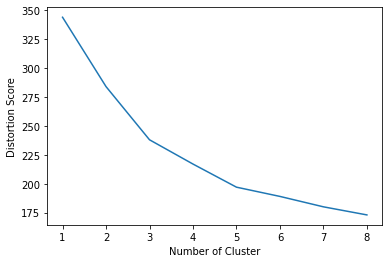

In [45]:
plt.plot(range(1,9,1),cost_list)
plt.ylabel('Distortion Score')
plt.xlabel('Number of Cluster')
plt.show()

In [46]:
km?

Type:        KModes
String form: KModes(init='Huang', n_clusters=5, n_init=5, verbose=1)
File:        ~/opt/anaconda3/lib/python3.7/site-packages/kmodes/kmodes.py
Docstring:  
k-modes clustering algorithm for categorical data.

Parameters
-----------
n_clusters : int, optional, default: 8
    The number of clusters to form as well as the number of
    centroids to generate.

max_iter : int, default: 100
    Maximum number of iterations of the k-modes algorithm for a
    single run.

cat_dissim : func, default: matching_dissim
    Dissimilarity function used by the k-modes algorithm for categorical variables.
    Defaults to the matching dissimilarity function.

init : {'Huang', 'Cao', 'random' or an ndarray}, default: 'Cao'
    Method for initialization:
    'Huang': Method in Huang [1997, 1998]
    'Cao': Method in Cao et al. [2009]
    'random': choose 'n_clusters' observations (rows) at random from
    data for the initial centroids.
    If an ndarray is passed, it should be of shap

In [61]:
#Inserted the best number of cluster -> 5 and writing the code into the data set


k_cluster_new = 5

km = KModes(n_clusters=k_cluster_new,random_state=3, init='Huang', n_init=5, verbose=1)

clusters = km.fit_predict(data)

# Print the cluster centroids

joins_new["Cluster Labels"]= km.labels_ +1

joins_new_visual = joins_new.join(veedel_data.set_index("Stadtteil"), on="Stadtteil")



Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 19, cost: 207.0
Run 1, iteration: 2/100, moves: 12, cost: 198.0
Run 1, iteration: 3/100, moves: 3, cost: 198.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 25, cost: 214.0
Run 2, iteration: 2/100, moves: 12, cost: 214.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 3, iteration: 1/100, moves: 29, cost: 206.0
Run 3, iteration: 2/100, moves: 13, cost: 202.0
Run 3, iteration: 3/100, moves: 0, cost: 202.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 4, iteration: 1/100, moves: 16, cost: 221.0
Run 4, iteration: 2/100, moves: 3, cost: 220.0
Run 4, iteration: 3/100, moves: 0, cost: 220.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 5, iteration: 1/100, moves: 20, cost: 207.0
Run 5, iteration: 2/100, mov

## Visualising geographical clusters

In [62]:

#Generating a color range for the style function
palette = sns.color_palette("hls", k_cluster_new)
palette = palette.as_hex()

#Generating a dict of Clusters

cluster_dict_new = joins_new_visual[["Stadtteil","Cluster Labels"]].set_index('Stadtteil').T.to_dict("records")[0]



mn = folium.Map(location=[50.86239, 6.9598939], tiles=None,zoom_start=10)

folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(mn)

folium.GeoJson(
    geo,
    style_function=lambda feature: {
        'fillColor': palette[cluster_dict_new[feature["id"]]-1],
        "opacity": 0.05,
        'color' : 'black',
        'weight' : 1}
    ).add_to(mn)

for lat, lon, poi, cluster in zip(joins_new_visual['Latitude'], joins_new_visual['Longitude'], joins_new_visual['Stadtteil'], joins_new_visual['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=1,
        popup=label,
        color=palette[cluster-1],
        fill=True,
        fill_color=palette[cluster-1],
        fill_opacity=0.2).add_to(mn)


mn


In [63]:
c1 =joins_new_visual.loc[joins_new_visual['Cluster Labels'] == 1]
print("-----Cluster Nr.1 ------\n")
print("Most common category: "+str(c1.groupby("1st Most Common Venue")["Stadtteil"].count().idxmax())+"\n")
print("Most common in: "+str(c1.groupby("1st Most Common Venue")["Stadtteil"].count().max())+" Neighboorhoods"+"\n")

print("Total Cluster Members: " +str(c1.shape[0])+"\n")
print("Share of all Neigborhoods: "+str(round(c1.shape[0]/86*100,2))+"%\n")
print(c1.groupby("Arbeitssuchend (%)")["Stadtteil"].count())
print(c1.groupby("Zuzug nach Köln (%)")["Stadtteil"].count())
print(c1.groupby("KFZ Quote")["Stadtteil"].count())
print(c1.groupby("Wahlbeteiligung (%)")["Stadtteil"].count())

-----Cluster Nr.1 ------

Most common category: Hotel

Most common in: 4 Neighboorhoods

Total Cluster Members: 19

Share of all Neigborhoods: 22.09%

Arbeitssuchend (%)
lowest      1
low         0
medium      2
high       15
highest     1
Name: Stadtteil, dtype: int64
Zuzug nach Köln (%)
lowest     2
low        4
medium     5
high       7
highest    1
Name: Stadtteil, dtype: int64
KFZ Quote
lowest     1
low        7
medium     5
high       3
highest    3
Name: Stadtteil, dtype: int64
Wahlbeteiligung (%)
lowest      3
low        13
medium      2
high        1
highest     0
Name: Stadtteil, dtype: int64


In [64]:
c2 =joins_new_visual.loc[joins_new_visual['Cluster Labels'] == 2]
print("-----Cluster Nr.2 ------\n")
print("Most common category: "+str(c2.groupby("1st Most Common Venue")["Stadtteil"].count().idxmax())+"\n")
print("Most common in: "+str(c2.groupby("1st Most Common Venue")["Stadtteil"].count().max())+" Neighboorhoods"+"\n")

print("Total Cluster Members: " +str(c2.shape[0])+"\n")
print("Share of all Neigborhoods: "+str(round(c2.shape[0]/86*100,2))+"%\n")
print(c2.groupby("Arbeitssuchend (%)")["Stadtteil"].count())
print(c2.groupby("Zuzug nach Köln (%)")["Stadtteil"].count())
print(c2.groupby("KFZ Quote")["Stadtteil"].count())
print(c2.groupby("Wahlbeteiligung (%)")["Stadtteil"].count())

-----Cluster Nr.2 ------

Most common category: Hotel

Most common in: 4 Neighboorhoods

Total Cluster Members: 21

Share of all Neigborhoods: 24.42%

Arbeitssuchend (%)
lowest      4
low        14
medium      3
high        0
highest     0
Name: Stadtteil, dtype: int64
Zuzug nach Köln (%)
lowest     11
low         1
medium      3
high        1
highest     5
Name: Stadtteil, dtype: int64
KFZ Quote
lowest     1
low        0
medium     6
high       5
highest    9
Name: Stadtteil, dtype: int64
Wahlbeteiligung (%)
lowest      1
low         1
medium      4
high       13
highest     2
Name: Stadtteil, dtype: int64


In [65]:
c3 =joins_new_visual.loc[joins_new_visual['Cluster Labels'] == 3]
print("-----Cluster Nr.3 ------\n")
print("Most common category: "+str(c3.groupby("1st Most Common Venue")["Stadtteil"].count().idxmax())+"\n")
print("Most common in: "+str(c3.groupby("1st Most Common Venue")["Stadtteil"].count().max())+" Neighboorhoods"+"\n")

print("Total Cluster Members: " +str(c3.shape[0])+"\n")
print("Share of all Neigborhoods: "+str(round(c3.shape[0]/86*100,2))+"%\n")
print(c3.groupby("Arbeitssuchend (%)")["Stadtteil"].count())
print(c3.groupby("Zuzug nach Köln (%)")["Stadtteil"].count())
print(c3.groupby("KFZ Quote")["Stadtteil"].count())
print(c3.groupby("Wahlbeteiligung (%)")["Stadtteil"].count())

-----Cluster Nr.3 ------

Most common category: Bakery

Most common in: 6 Neighboorhoods

Total Cluster Members: 16

Share of all Neigborhoods: 18.6%

Arbeitssuchend (%)
lowest      2
low         1
medium     11
high        2
highest     0
Name: Stadtteil, dtype: int64
Zuzug nach Köln (%)
lowest     1
low        8
medium     3
high       3
highest    1
Name: Stadtteil, dtype: int64
KFZ Quote
lowest     2
low        3
medium     3
high       7
highest    1
Name: Stadtteil, dtype: int64
Wahlbeteiligung (%)
lowest      0
low         1
medium     11
high        2
highest     2
Name: Stadtteil, dtype: int64


In [66]:
c4 =joins_new_visual.loc[joins_new_visual['Cluster Labels'] == 4]
print("-----Cluster Nr.4 ------\n")
print("Most common category: "+str(c4.groupby("1st Most Common Venue")["Stadtteil"].count().idxmax())+"\n")
print("Most common in: "+str(c4.groupby("1st Most Common Venue")["Stadtteil"].count().max())+" Neighboorhoods"+"\n")

print("Total Cluster Members: " +str(c4.shape[0])+"\n")
print("Share of all Neigborhoods: "+str(round(c4.shape[0]/86*100,2))+"%\n")
print(c4.groupby("Arbeitssuchend (%)")["Stadtteil"].count())
print(c4.groupby("Zuzug nach Köln (%)")["Stadtteil"].count())
print(c4.groupby("KFZ Quote")["Stadtteil"].count())
print(c4.groupby("Wahlbeteiligung (%)")["Stadtteil"].count())

-----Cluster Nr.4 ------

Most common category: Bakery

Most common in: 4 Neighboorhoods

Total Cluster Members: 16

Share of all Neigborhoods: 18.6%

Arbeitssuchend (%)
lowest      0
low         0
medium      0
high        0
highest    16
Name: Stadtteil, dtype: int64
Zuzug nach Köln (%)
lowest     3
low        4
medium     4
high       2
highest    3
Name: Stadtteil, dtype: int64
KFZ Quote
lowest     12
low         2
medium      1
high        0
highest     1
Name: Stadtteil, dtype: int64
Wahlbeteiligung (%)
lowest     14
low         2
medium      0
high        0
highest     0
Name: Stadtteil, dtype: int64


In [67]:
c5 =joins_new_visual.loc[joins_new_visual['Cluster Labels'] == 5]
print("-----Cluster Nr.5 ------\n")
print("Most common category: "+str(c5.groupby("1st Most Common Venue")["Stadtteil"].count().idxmax())+"\n")
print("Most common in: "+str(c5.groupby("1st Most Common Venue")["Stadtteil"].count().max())+" Neighboorhoods"+"\n")

print("Total Cluster Members: " +str(c5.shape[0])+"\n")
print("Share of all Neigborhoods: "+str(round(c5.shape[0]/86*100,2))+"%\n")
print(c5.groupby("Arbeitssuchend (%)")["Stadtteil"].count())
print(c5.groupby("Zuzug nach Köln (%)")["Stadtteil"].count())
print(c5.groupby("KFZ Quote")["Stadtteil"].count())
print(c5.groupby("Wahlbeteiligung (%)")["Stadtteil"].count())

-----Cluster Nr.5 ------

Most common category: Café

Most common in: 6 Neighboorhoods

Total Cluster Members: 14

Share of all Neigborhoods: 16.28%

Arbeitssuchend (%)
lowest     11
low         2
medium      1
high        0
highest     0
Name: Stadtteil, dtype: int64
Zuzug nach Köln (%)
lowest     1
low        0
medium     2
high       4
highest    7
Name: Stadtteil, dtype: int64
KFZ Quote
lowest     2
low        5
medium     2
high       2
highest    3
Name: Stadtteil, dtype: int64
Wahlbeteiligung (%)
lowest      0
low         0
medium      0
high        1
highest    13
Name: Stadtteil, dtype: int64
